In [1]:
%matplotlib notebook
import numpy as np
import matplotlib.pyplot as plt

from __animacija2D import animacija2D
from __metode import gradSpust2D

**Linearna regresija**

To je postopek ugibanja linearne premice na podlagi vnaprej podanih točk. Predstavljamo si lahko klasičen problem *Hookovega zakona* kjer imamo vzmet, za katero hočemo izračunati koeficient razteznosti. 

$F = k \Delta x$

Merimo lahko dolžino vzmeti in silo, s katero vlečemo vzmet. Pričakujemo linearno odvisnost, ki pa je tipično zašumljena zaradi številnih vplivov, ki jih ne moremo nadzorovati kot npr. merske napake.

In [2]:
a, b = 0.62, 0.39
def linear(x, a, b):
    return (x*a+b)

Najprej generirajmo zašumljen nabor meritev.

In [3]:
n = 50
xrange = (-1, 1)
x = np.sort(np.random.random(n)*(xrange[1]-xrange[0])+xrange[0])

c = 0.25
y = linear(x, a, b) + c*(np.random.random(n)-0.5)

Zopet vidimo, da gre za optimizacisjki problem najboljše rešitve. Da pa bomo lahko uporabili **gradientni spust** moramo minimizirati vrednost neke funkcije. V ta namen uporabljamo t.i. **cenovne funkcije** preko katerih definiramo kazen oz. nagrado, ki jo želimo maksimizirati. V našem primeru je to [**povrepčna kvadratna napaka**](https://en.wikipedia.org/wiki/Mean_squared_error) (ang. *mean squared error*), ki jo definiramo kot:

$$
MSE = \frac{1}{n} \sum_{i=1}^{n} (f(x^{(i)}) - y^{(i)})^2
$$

kjer je $n$ število meritev, $f(x^{(i)})$ je vrednost linearne funkcije $f$ pri $i$-ti meritvi, $y^{(i)}$ pa je prava vrednost meritve.


In [4]:
def MSE(x0):
    """ Mean Squared Error """
    ai, bi = x0
    vsota = 0.
    for i in range(n):
        vsota += np.power(y[i]-(x[i]*ai+bi), 2)
    return vsota/n

Poglejmo si kako dobro delujejo metode iz strokovnih knjižnic.

In [5]:
from scipy.optimize import least_squares

# Primer še boljše metode, ki se uporablja v takšnih problemih!
print(least_squares(MSE, [0.9, 0.0]))

     message: `gtol` termination condition is satisfied.
     success: True
      status: 1
         fun: [ 4.199e-03]
           x: [ 6.496e-01  3.746e-01]
        cost: 8.817853085634125e-06
         jac: [[ 1.479e-06 -1.515e-07]]
        grad: [ 6.213e-09 -6.363e-10]
  optimality: 6.212992989409535e-09
 active_mask: [ 0.000e+00  0.000e+00]
        nfev: 24
        njev: 15


<IPython.core.display.Javascript object>


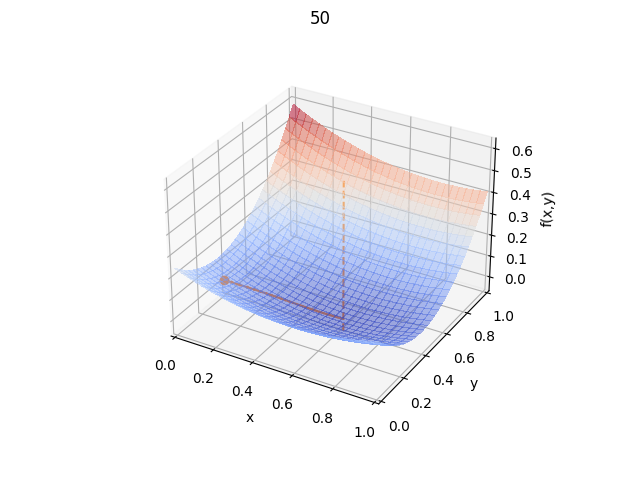

<IPython.core.display.Javascript object>


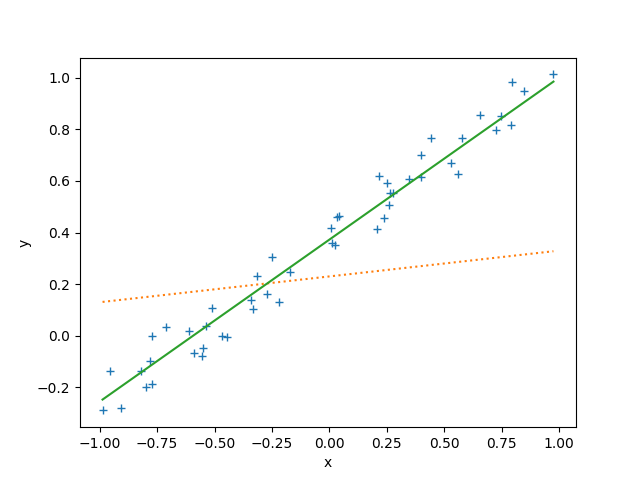

(0.6273747345076504, 0.37262748110656524) 0.0043519729692793946 51


In [7]:
# Rešitev iščemo v režimu
xlim = (0.,1.)
ylim = (0.,1.)

# Skiciranje funkcije
ani = animacija2D(MSE, xlim, ylim, fN=20)

# Risanje grafa linearnih funkcij
plt.figure()
plt.plot(x, y, linestyle="", marker="+")
plt.xlabel("x")
plt.ylabel("y")

# POSKUSI zagnati kakšno metodo več pod drugačnimi pogoji! (glej zakomentirane primere)
# Potek metod za par korakov-----------------------------------------------------------
a1, b1 = 0.1, 0.23
plt.plot(x, linear(x, a1, b1), linestyle=":")
a1, b1 = ani.racunaj(metoda=gradSpust2D, x0=a1, y0=b1, par=[0.1, 0.0001], N=50)
plt.plot(x, linear(x, a1, b1))

# Zagon animacije
ani.narisi(casAnimacije=500, verbose=1, jupyter=True)
plt.show()

<IPython.core.display.Javascript object>


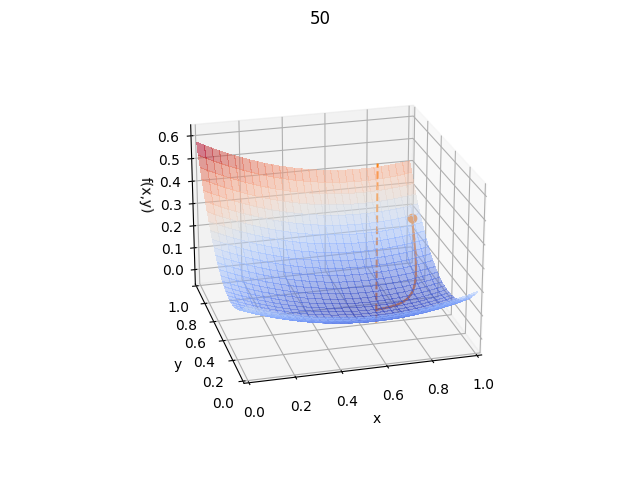

<IPython.core.display.Javascript object>


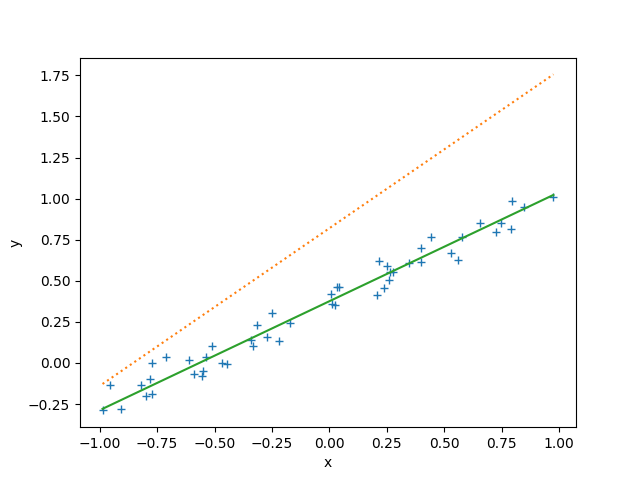

(0.6634233205423599, 0.37580226307645315) 0.004258413228279786 51


In [8]:
# Rešitev iščemo v režimu
xlim = (0.,1.)
ylim = (0.,1.)

# Skiciranje funkcije
ani = animacija2D(MSE, xlim, ylim, fN=20, elev=55, azim=-155)

# Risanje grafa linearnih funkcij
plt.figure()
plt.plot(x, y, linestyle="", marker="+")
plt.xlabel("x")
plt.ylabel("y")

# POSKUSI zagnati kakšno metodo več pod drugačnimi pogoji! (glej zakomentirane primere)
# Potek metod za par korakov-----------------------------------------------------------
a2, b2 = 0.96, 0.82
plt.plot(x, linear(x, a2, b2), linestyle=":")
a2, b2 = ani.racunaj(metoda=gradSpust2D, x0=a2, y0=b2, par=[0.1, 0.0001], N=50)
plt.plot(x, linear(x, a2, b2))

# Zagon animacije
ani.narisi(casAnimacije=500, verbose=1, jupyter=True)
plt.show()

In [8]:

# Rešitev iščemo v režimu
xlim = (0.,1.)
ylim = (0.,1.)

# Skiciranje funkcije
ani = animacija2D(MSE, xlim, ylim, fN=20, elev=55, azim=-125)

# Risanje grafa linearnih funkcij
plt.figure()
plt.plot(x, y, linestyle="", marker="+")
plt.xlabel("x")
plt.ylabel("y")

# Potek metod do konvergence-----------------------------------------------------------
a3, b3 = 0.9, 0.05
plt.plot(x, linear(x, a3, b3), linestyle=":")
a3, b3 = ani.racunaj(metoda=gradSpust2D, x0=a3, y0=b3, par=[0.1, 0.0001], eps=1e-5, konv=True)
plt.plot(x, linear(x, a3, b3))

# Zagon animacije
ani.narisi(casAnimacije=500, verbose=1, jupyter=True)
plt.show()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

(0.6182310847601236, 0.37200351886636085) 0.005734693660114969 44
